# 1. Preperation

## 1.1 Manage Environment

`conda create -n env_name list_of_pkg`(eg:numpy)

To specify the version of python:
    
     conda create -n py python=3.3
     conda create -n py3 python=3
     
After creating the specified environment, use `source active my_env` to enter the environment. You can use `conda list` to check whether it only contains the pkg you included. 

Use `source deactovate` to leave the environment.
     


## 1.2 Share Environment

sharing your environment can let others use all pkg installed in your environment with the same version.

    conda env export > environment.yaml
    
    this is to save the environment as YAML, now you can share this YAML.
    
To create the same environment, use `conda env create -f environment.yaml` This will create a new environment that contains whatever the pkg in environment.yaml

If you forget the name of environment, use `conda env list` to check all environment. The current environment you are in will be marked with a ** * **.

To delete a environment, use `conda env remove -n env_name`

[more information with Conda](https://conda.io/docs/user-guide/tasks/index.html)

[Latex Info](http://data-blog.udacity.com/posts/2016/10/latex-primer/)

[Markdown Info](https://github.com/adam-p/markdown-here/wiki/Markdown-Cheatsheet)

## 1.3 Magic Keyword

To count the loop number and running time of func1, use `%timeit func1(..)`

To count the running time for the entire cell, include `%%timeit` at the beginning of that cell before functions implementation

`%matpotlib inline`

`config InlineBackend.figure_format = 'retina'`

**matpotlib** enables user to see both the code and data visualization. Adding **inline** allows the visualization be in a new cell. Specifying **Retina** will create the graph with higher resolution.

--------------------------------------------------------------------------


# 2. Supervised Learning

Supervised Learning:

1. form an album of tagged photos, recognize someone in a picture
2. given someone's music choices and a bunch of features of that music, recommend a new song

Not Supervised Learning:

1. analyze bank data for weird-looking transactions and flag those for fraud 
    
    **(we have not defined what a "weird-looking transaction" is)**
    
    
2. cluster udacity student into types based on learning style
    
    **(because we do not know what type of students are and we might not know how many students we are looking for)**



### Lecture 11 Naive Bayes

* **Decision Surface** in scatter plot: a surface to separate groups of plots
    * linear decision surface
    

* **Naive Bayes to find a simple linear decision surface:**

    Example: 
        use algorithm to define whether car can drive fast or slow based on the bumpiness and slope of the road
        
    Algorithm: **sklearn.naive_bayes.GaussianNB**
    
Example code:

In [1]:
import numpy as np
X =np.array([[-1, -1], [-2, -1], [-3, -2], [1, 1], [2, 1], [3, 2]])
Y = np.array([1, 1, 1, 2, 2, 2])
from sklearn.naive_bayes import GaussianNB
clf = GaussianNB()
clf.fit(X, Y)
print(clf.predict([[-0.8, -1]]))

clf_pf = GaussianNB()
clf_pf.partial_fit(X, Y, np.unique(Y))
print(clf_pf.predict([[-0.8, -1]]))

[1]
[1]


Explanation: 

`clf = GaussianNB()` create a classifior 

`clf.fit(X,Y)` fit(X,Y,*sample_weight=None)

`clf.partial_fit(X,Y,class=None,sample_weight=None)` Incremental fit on a batch of samples. This is called several times consevutively on different chunks of a dataset so as to implement out-of-core or online learning. This's especially useful when the whole dataset is too big to fit in memory at once
    
  * **classes:** list of all the c;lasses that can possibly appear in the y vector[must be provided at the first call, can be omitted later]
   
  * **sample_weight:** weights applied to individual samples[1. for unweighted]

`predict(X)` perform classification on an array of test vectors X

`score(X,Y, sample_weight=None)` returns the mean accuracy on the given test data and labels

> Extra Knowledge of Python
    List Comprehensions:
    
         S = [x**2 for x in range(10)]
        
         V = [2**i for i in range(13)]
        
         M = [x for x in S if x % 2 == 0]
        
         print S; print V; print M
        
        [0, 1, 4, 9, 16, 25, 36, 49, 64, 81]

        [1, 2, 4, 8, 16, 32, 64, 128, 256, 512, 1024, 2048, 4096]
    
        [0, 4, 16, 36, 64]

Now, we would like to print out the accuracy:
accuracy = no. of points classified correctly (in test set)

`from sklearn.metrics import accuracy_score`

`print accuracy_score(pred, labels_test)`

** you train and test on different set of data, if you did not do that, you may overfit your data **

-------------------------------------------------

### Lecture 13 SVM

Key idea: __Maximize__ the Margin but put the priority to classify all points correctly.

Example:

In [2]:
from sklearn import svm
x = [[0, 0], [1,1]]
y = [0, 1]
clf = svm.SVC()
clf.fit(x,y)

clf.predict([[2., 2.]])


array([1])

Now the problem is __what if our dataset is not linear seperable?__ Remember so far all the SVM is giving us the linear seperation line

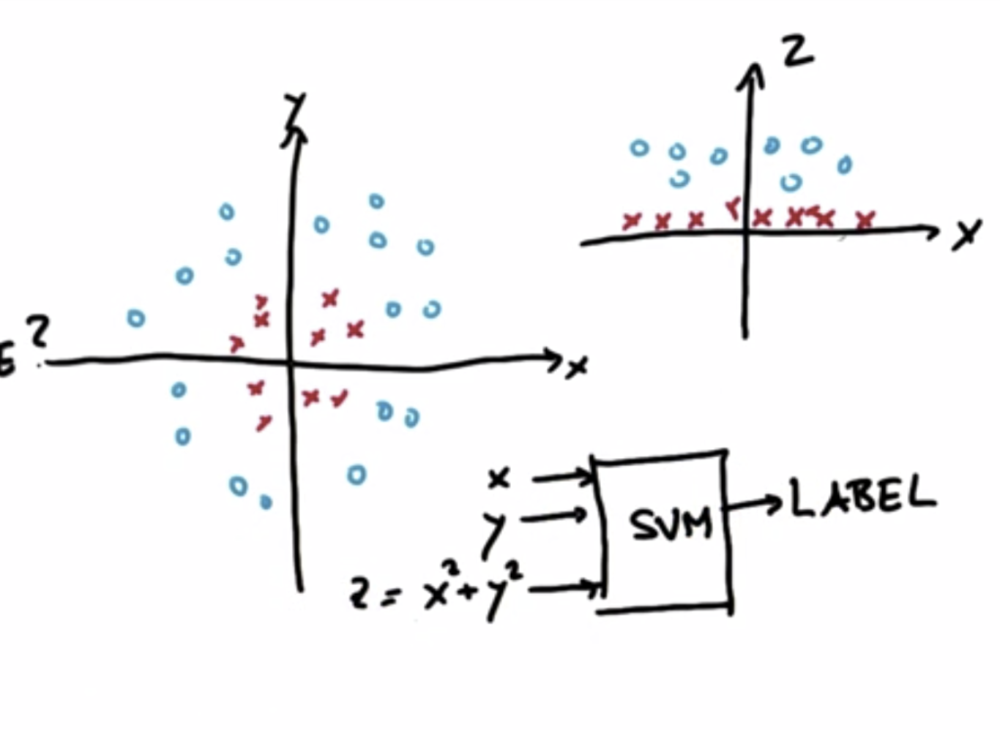

Let's take a look of the above image. On the left graph, clearly there are two inputs (features) x and y. And there is no linear seperable line to seperate blue and red points. At this condition, we will try to introduce a third input also named a third feature. Based on our mathematical knowledge, we can introduce feature Z = x^2 + y^2 and Z is representing the distance from each dot to origin. With this third input, we can transform the original graph into the one on the right and clearly there is a line to seperate them. Note this method of introducing new features in essence raises the dimension. The new transformed graph has x and z axises.

The line to seperate blue and red dots might be Z = 1 that is x^2 + y^2 = 1, a circle in the original graph with radius equals 1

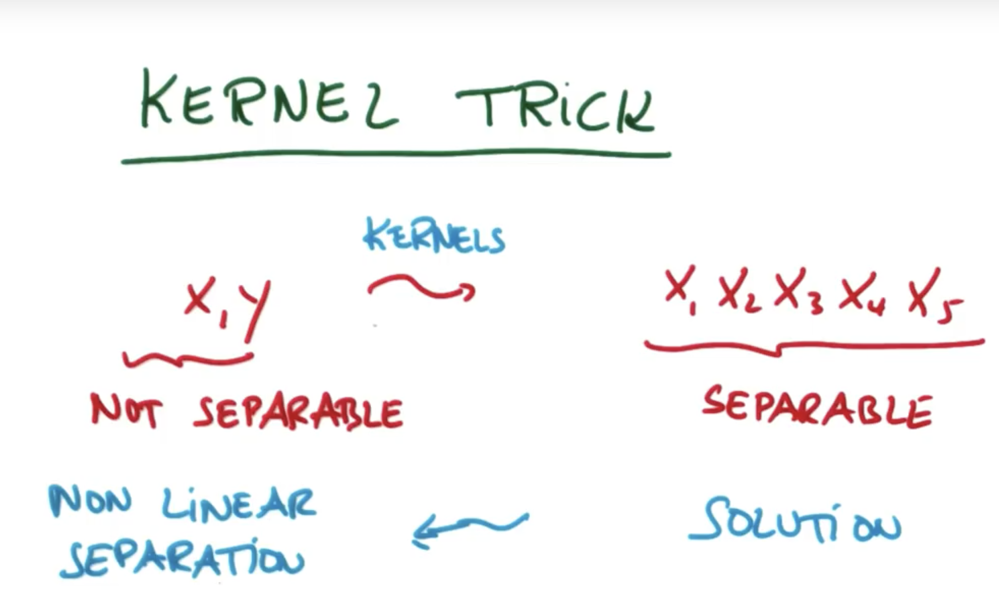

__To summary, in SVM, there is functionality called "Kernal" to help you seperate dots in this situation. __

First, x and y are not linear separable and SVM will automatically apply a trick called kernal. Kernal serves like a function but actually it is not. Kernal will introduce higher dimensions by introducing new features/variables until the dots are now separable. Once SVM finds this solution, it will try to transform this seperation line back into the original graph to perform a non-linear separation.

__Now let's go back to coding to see how we can support the usage of kernal in SVM?__

[Difference Kernals in SVM](http://scikit-learn.org/stable/modules/svm.html#svm-kernels) Common kernels are provided, but it is also possible to specify custom kernels.


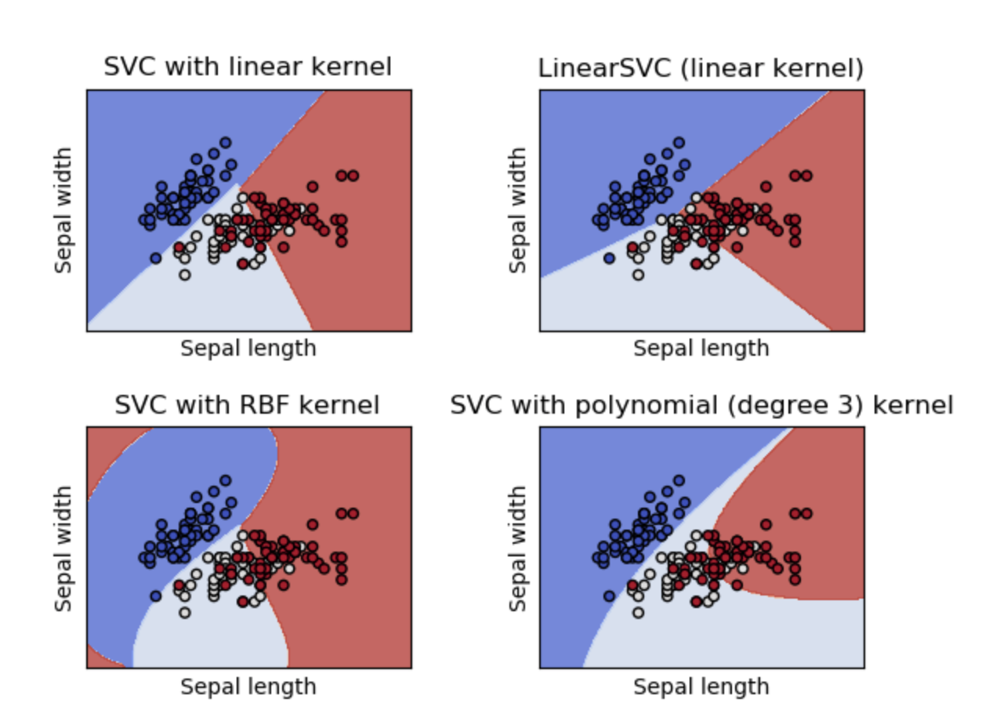

Note that Scikit-learn provides different types of SVM and right now we are using SVC (Support Vector Classifier)

`class sklearn.svm.SVC(C=1.0, kernel=’rbf’, degree=3, gamma=’auto’, coef0=0.0, shrinking=True, probability=False, tol=0.001, cache_size=200, class_weight=None, verbose=False, max_iter=-1, decision_function_shape=’ovr’, random_state=None)`

[SVC Document](http://scikit-learn.org/stable/modules/generated/sklearn.svm.SVC.html#sklearn.svm.SVC)

### Important Parameters:

* Kernel
* Gamma (does not influence linear kernel)
* C

__C Parameter in details:__

it controls the tradeoff between __smooth decision boundary__ and __classifying training points correctly__

A larger C mean you expect more training points correctly, your model might be more complex

### Overfitting:

One reason that it happens is because you take data too literal. Data can be linearly seperated but is seperated by a very complicated non-linear boundary. One way to reduce over-fitting is to by parameters.

### Disadvantage:

* Dataset should not be too large and features should not be too many as the running time is increasing as cubic
* SVM does not work very well when there are a lot of noises as they might be prone to overfitting to some of the noise in your data. So when the class are very overlapping you have to count independent evidence. A naive bayes model will be better.

### Extra Important Knowledge About SVM:

[SVM analysis](https://discussions.youdaxue.com/t/topic/6360/3)

__Tradeoff of algorithm processing speed and training accuracy:__

    sometimes you would like to increase the speed at the cost of accuracy by cutting your training dataset to be smaller. for example, voice recognition, credit card fraud..

-------------------------------------------------

### Lecture 16 Decision Tree

Just as in SVM, you were able to use a kernel trick, to change from linear to non-linear decision surfaces. Decision tree uses a trick to let you do non-linear decision making with simple linear decision surface.

Decision tree can be used for classification and regression.

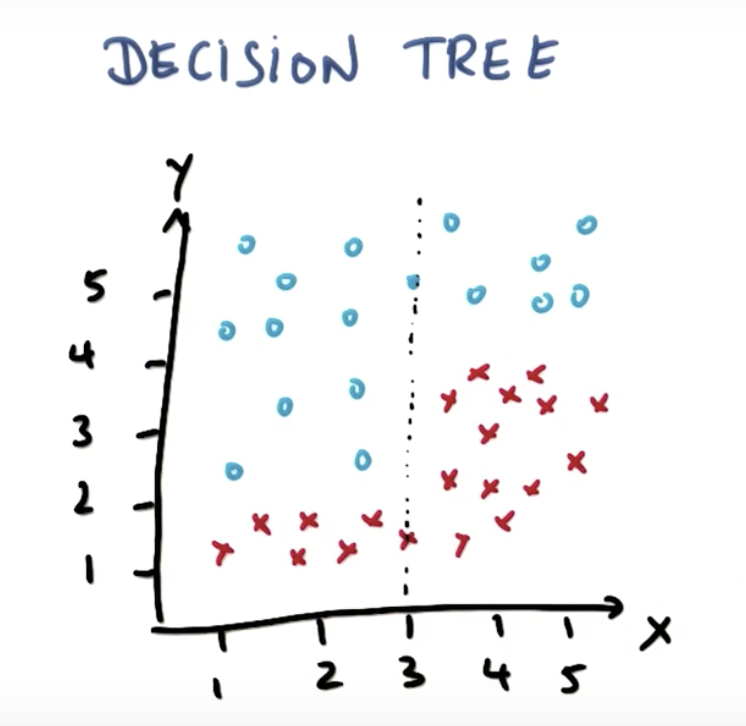

__This graph, to use decision tree, we need to seperate data points by x =3. After doing this, left and right sides are both linear seperable.__

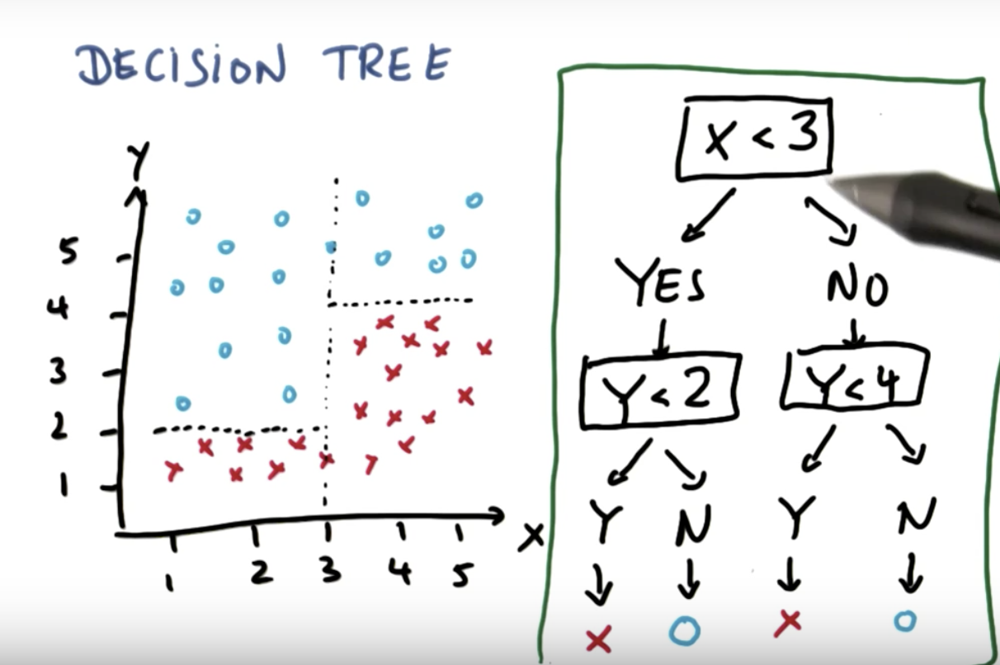

### Coding Document

We will use `DecisionTreeClsssifier` takes as input two arrays, n_samples and n_features.

In [3]:
from sklearn import tree
X = [[0,0],[1,1]]
Y = [0,1]
clf = tree.DecisionTreeClassifier()
clf = clf.fit(X,Y)
    
clf.predict([[2.,2.]])

array([1])

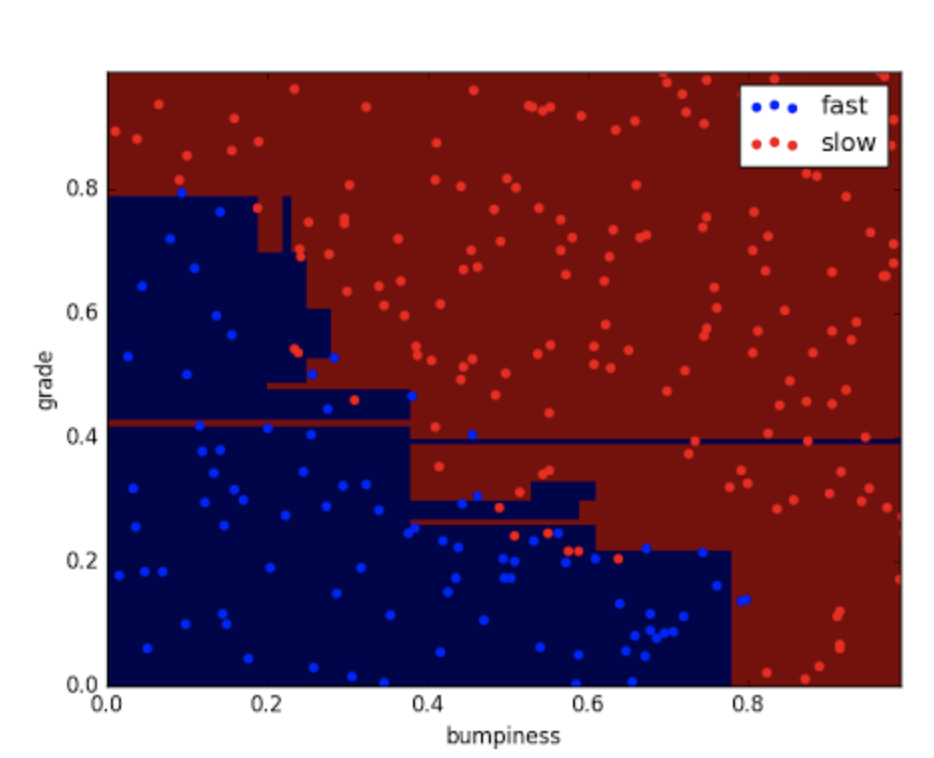

__Accuracy_score = 0.912__

__Apparently there are overfitting__

### Parameters:

[Document](https://scikit-learn.org/stable/modules/generated/sklearn.tree.DecisionTreeClassifier.html)

```class sklearn.tree.DecisionTreeClassifier(criterion=’gini’, splitter=’best’, max_depth=None, min_samples_split=2, min_samples_leaf=1, min_weight_fraction_leaf=0.0, max_features=None, random_state=None, max_leaf_nodes=None, min_impurity_decrease=0.0, min_impurity_split=None, class_weight=None, presort=False)```

* Criterion
* Splitter
* Max_depth
* __Min_samples_split (related to overfitting)__
* Min_samples_leaf

Note, for Criterion, the default is gini index, which is another similar metric of impurity (taught later in entropy block) 

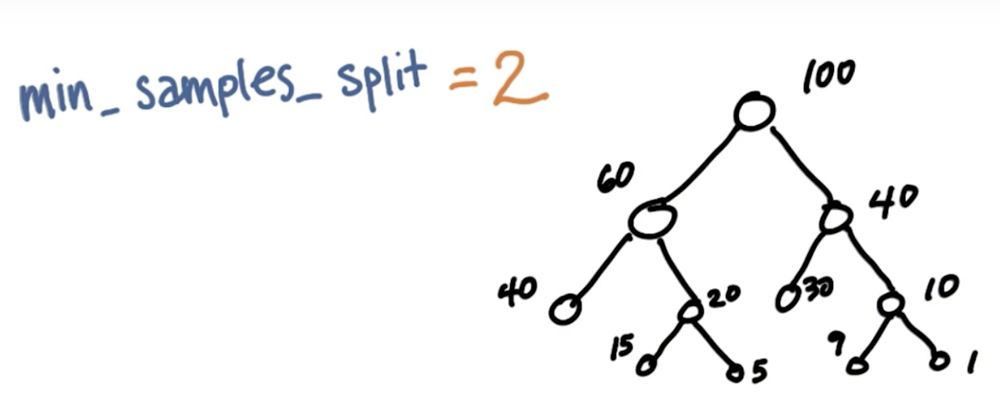


There are 100 samples at the beginning, the default setting of min_samples_split is 2, so as long as the branch has more than or equal to 2 samples, decision tree will keep splitting the samples.

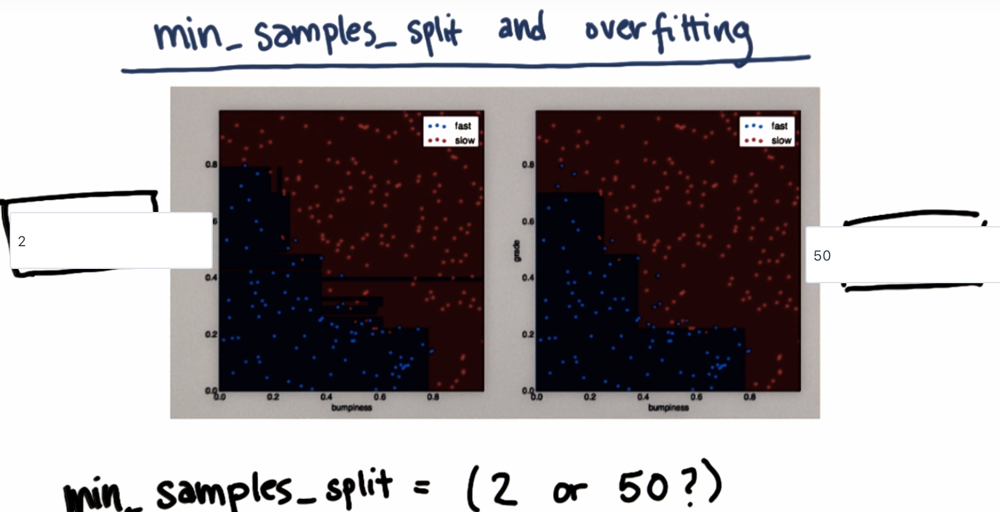

{"message": "{'acc_min_samples_split_50': 0.848, 'acc_min_samples_split_2': 0.908}"}


### Entropy

Controls how a decision tree decides where to split the data

Definition: Measure of __impurity__ in a bunch of examples.

Examples to illustrate:

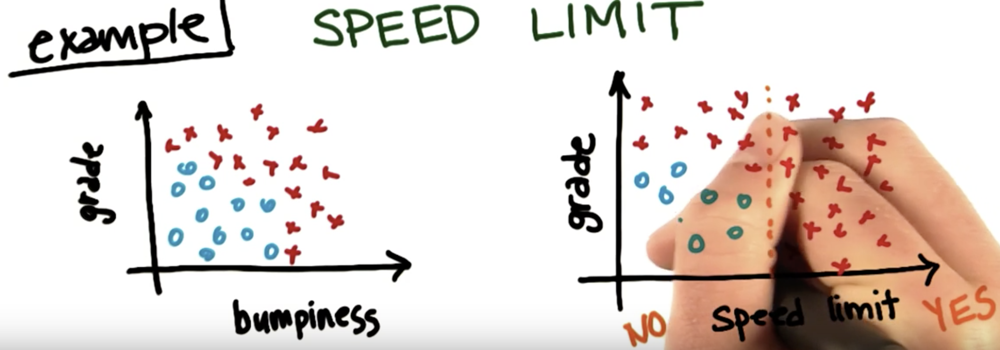


Remember the self-driving car speed test. We used to consider property of grade and bumpiness. Now we would like to introduce a new featuere, the speed limit, as the second graph. When it goes over the limit, it will be cross mark as you shall not drive with violation of traffic law. When it is below the limit, it still depends on the bumpiness and there are cases you can drive or cases you shall not drive fast

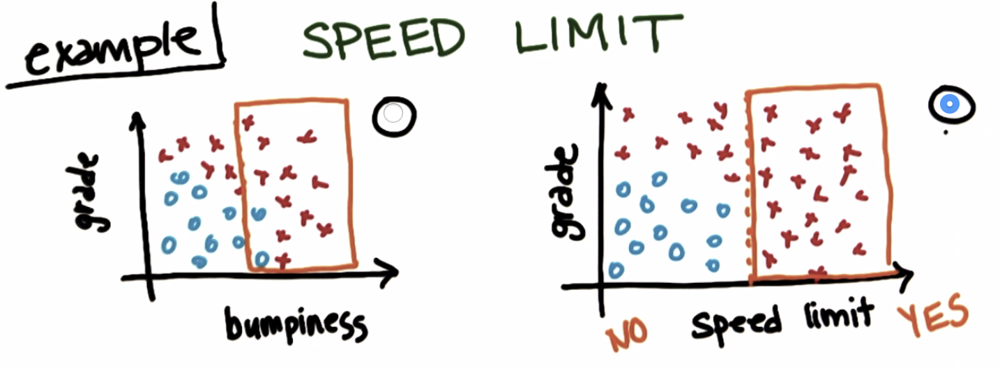

If we only consider the above two highlighted areas. which one has a better purity. For these graphs, the right one is more pure. So the odeal idea of decision tree is to find a split point and __after the splitting of data, the subsets of the data can be as pure as possible.__

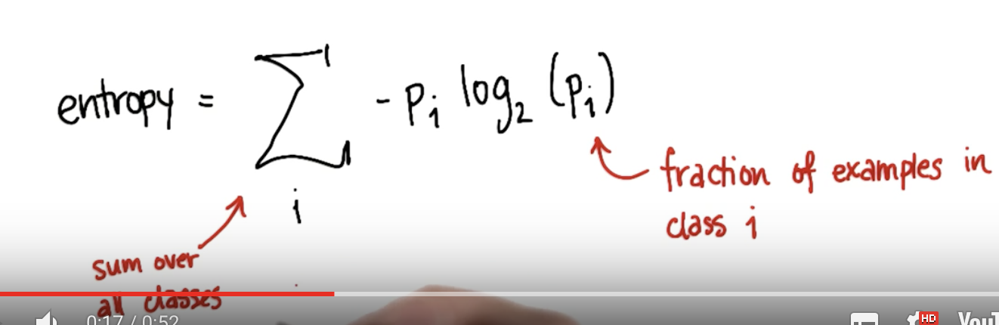

This is the function of calculating the entropy. Entropy is using log with base number as 2. In our situation, we only have two categories/classes and at this situation, the maximum value of this function is 1. If you use base number as 10, the max number of entropy might be changed as well. 

Remember that entropy is measuring __impurity__. thus a small value of entropy means the data is more pure and uniform.

* __If all examples are same class -> entropy = 0__
* __If all examples are evenly split between classes -> entropy = 1__

### Calculate Entropy:

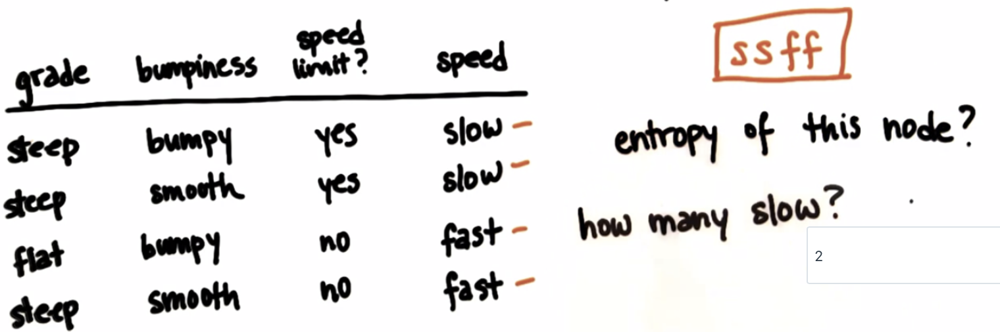

Lets calculate the entropy of this example!

1. there are two classes: slow and fast. So Pi, i = slow or fast
2. P(slow) = 0.5 = P(fast)
3. Sub into the equation, we get ```-0.5 * log(0.5,2) - 0.5 * log(0.5,2) = 1```
4. This means __this is the most impuried sample__ we can get

Note: we can use Scipy in python to calculate:

    import scipy.stats
    print scipy.stats.entropy([2,1],base=2)

###  let's see how entropy affects decision tree in drawing boundaries

__Infomration Gain__

__Information Gain = entropy of parents - the weighted average of the entropy of children (result if you split the parent data)__

__And Decision Tree will try to maximie the informstion gain__

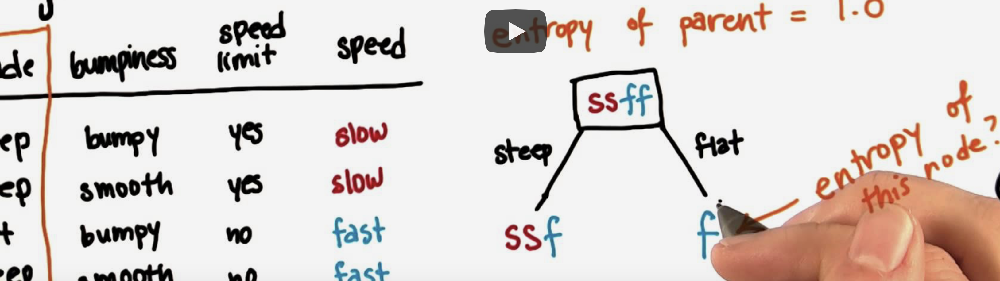

Let's use the same example to illustrste. We first split based on grade. 
1. After calculation of entropy, the left branch (SSF) has entropy of ```-2/3log(2/3) - 1/3log(1/3) = 0.918``` while the right branch has entropy of 0 as its perfectly pure
2. Next we will multiply them by their weighted average:
    ```Information Gain = 1 - 3/4 * 0.918 - 1/4 * 0 = 0.3112```
3. This is the infomration gain we get based on the split of grade
4. Next we look at bumpiness. After all calculation, we know that if we split based on bumpiness, we will have infomration gain equals 0 
5. For speed limit, the information gain will be 1
6. In conclusion, we would like to split based on speed limit

### Bias and Variance in Supervised Learning

A high bias machine learning algorithm is one that practically ignores the data. It has almost no capcity to learn anything. (no matter how i train the model, it does not do anything differently) This is not what we expect for machine learning. Another extreme is to make our model that is extremely perceptive to data. It only replicates stuffs that it has seen before. We call this an extremely high variance algorithm. (it reacts very poorly in the situation that it hasn't seen because it does not have the right bias to generalize to new stuff.

In reality, we would like something in the middle. You want an algorithm that has some authority to generlize but is still open to data.

### Disadvantage of Decision Tree:

Prone to overfitting especially when there are large amounts of features in . Be careful with parameters (accuracy score is important to know when to stop growing our DT).

For example, if one branch only has one data point, then it is likely to be overfitted.

### Advantage:

You can build bigger classifier out of decision tree classifier in something called ensember methods.

### Enriched Document:

[Document of DT](https://discussions.youdaxue.com/t/topic/6364)

-------------------------------------------------

### Lecture 19 Regression

* Continuous prediction

+ Note to find min R-square value, take derivative and set value = 0


#### Coding Section:

Ordinary Least Square -> ```lineargression```

In [4]:
from sklearn import linear_model
reg = linear_model.LinearRegression()
reg.fit([[0,0],[1,1],[2,2]], [0,1,2])
# LinearRegression(copy_x=true, fit_intercept=true, normalize=false)
reg.coef_

array([0.5, 0.5])

In [5]:
import numpy as np
predict_data = np.array([[3,4],[5,6]])
print "let's make a prediction:", reg.predict(predict_data) 
#note it expect a list of data, so put it in a list

print "slope:", reg.coef_
print "intercept:", reg.intercept_

#R squared Score:
x_test = [[0,0],[1,1],[2,2]]
y_test = [0,1,2]

print "r-squared score:", reg.score(x_test, y_test)
#here we use test dataset to get score, this would result in overfitting

let's make a prediction: [3.5 5.5]
slope: [0.5 0.5]
intercept: 2.220446049250313e-16
r-squared score: 1.0


__Usually our training_x and training_y is formatting like [[1],[3],[5]...]
then the predict can be passed with argument like [27]__

__The higher the R-square is, the better__

__The best regression is the one that minimize the sum of squared errors. We have several algorithms to do that:__
        * Ordinary Least Square(OLS)
        * gradient Descent
        
Remark: there can be multiple lines that can minimize the absolute value of error but only one line that minimize the error squared. Also using the sum of squared errors can make implementation easier.

__Sum of Squared Errors method is not perfect:__

Check the below two graph, they are all doing a great regressing fitting. However, if you calculate the SSE, the right one will have a larger SSE. Since the larger SSE we have, the worse the fitting will be. So if we only compare which one has a smaller SSE, it is not accurate enough sometimes.

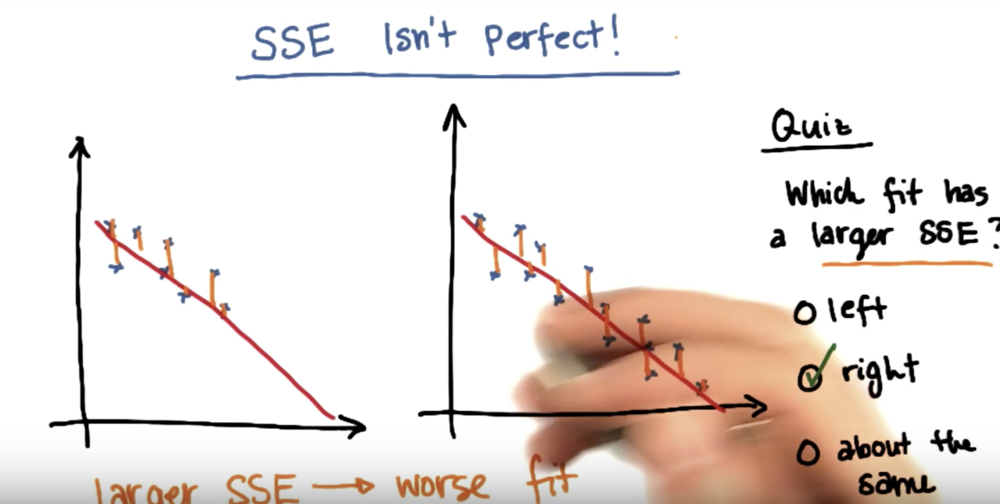

Because of the above limitation of SSE, people usually use another method that does not have the same problem: ```R^2 of a regression```

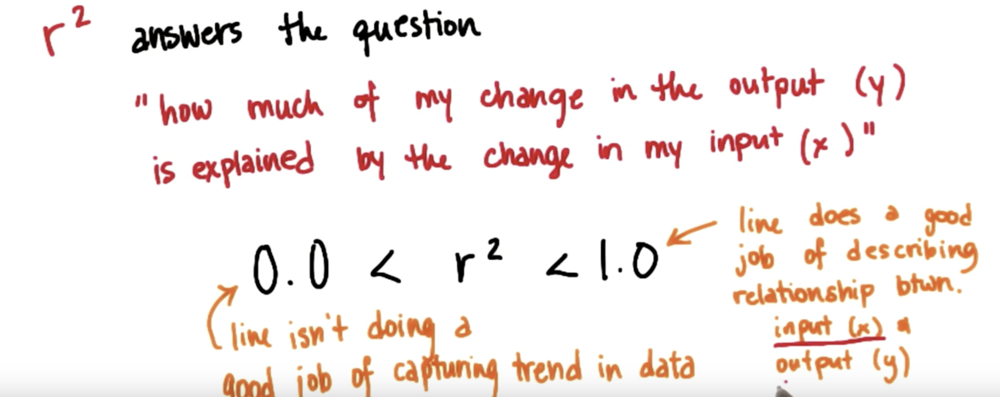

Note that R2 is only bounded from below by 0 when evaluating a linear regression on its training set. If evaluated on a significantly different set, where the predictions of a regressor are worse than simply guessing the mean value for the whole set, the calculation of R2 can be negative.

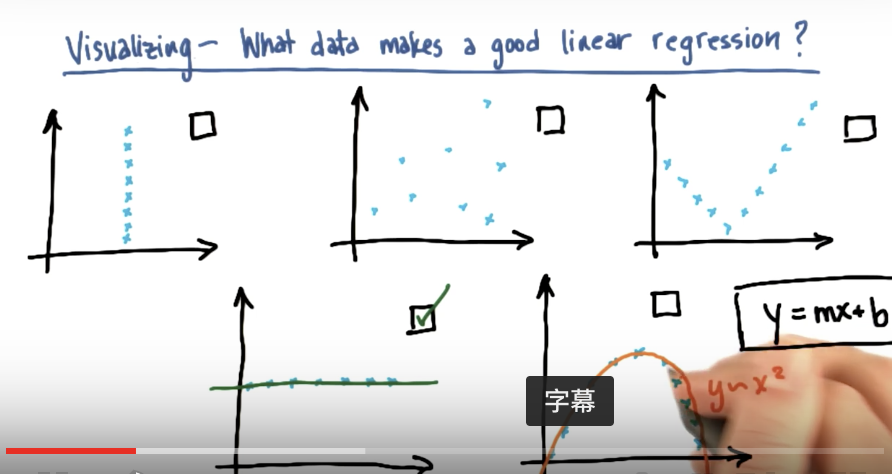

__The leftmost one is not good to use linear regression because when you check y = mx+b, the meaning is by varying x values, we can get change of y velus. However, when equation is trying to fit this data, you might get infinity for m.__

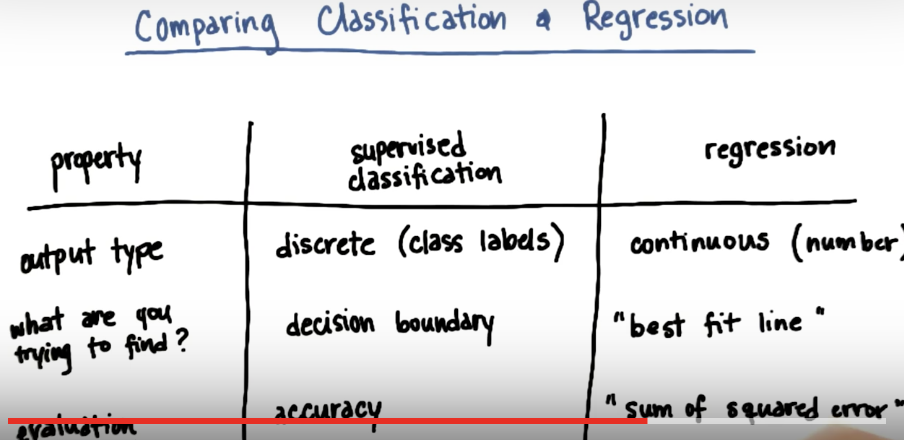

But you should think about regression as a type of supervised learning

### Multi-Variate Regression

We have existing software to calculate relationship between x1 and x2 to get y.

-------------------------------------------------

### Lecture 21 Outliers

Outlier Detection:
  1. Train
  2. Remove 10% of data points having largest residual error
  3. Train Again

-------------------------------------------------

### Lecture 23 Cross Validation


### Here is some tools for your to separate your data into training and testing dataset in Sklearn

__[Cross Validation: evaluating estimator performance](http://scikit-learn.org/stable/modules/cross_validation.html)__


In [6]:
import numpy as np
from sklearn import cross_validation
from sklearn import datasets
from sklearn import svm

iris = datasets.load_iris()
print "datashape and targetshape:", iris.data.shape, iris.target.shape

datashape and targetshape: (150, 4) (150,)


/Users/gabriel/anaconda2/lib/python2.7/site-packages/sklearn/cross_validation.py:41: DeprecationWarning: This module was deprecated in version 0.18 in favor of the model_selection module into which all the refactored classes and functions are moved. Also note that the interface of the new CV iterators are different from that of this module. This module will be removed in 0.20.
  "This module will be removed in 0.20.", DeprecationWarning)


Dataset in Sklearn has various different datasets, and iris is one of them. ```load_iris()``` is used to load and return the dataset(classification)

__IRIS:__
Dictionary-like object, the interesting attributes are: ‘data’, the data to learn, ‘target’, the classification labels, ‘target_names’, the meaning of the labels, ‘feature_names’, the meaning of the features, and ‘DESCR’, the full description of the dataset.

```.data.shape``` and ```.target.shape``` are two features to know the dimensions of data and target numpy arrays

Imagine if you are interested in the sample 10,25,50 and want to know their class name:

In [7]:
iris.target[[10,25,50]]
## array([0,0,1])
list(iris.target_names)

['setosa', 'versicolor', 'virginica']

In [8]:
##Lets back to the cross validation, now we will split the dataset iris

X_train, X_test, y_train, y_test = cross_validation.train_test_split(
    iris.data, iris.target, test_size = 0.4, random_state=0)

print X_train.shape, y_train.shape
print X_test.shape, y_test.shape

(90, 4) (90,)
(60, 4) (60,)


__Further Explanation__

So we would like to maximize both training dataset size and testing dataset size. Clearly there is a tradeoff here. How we should select the test_size features involves the idea of __K Fold Cross Validation__

Imagine you have 200 datapoints, now lets set k = 10. 200 / 10 = 20. So now we divide 200 datapoints into ten groups and each group has 20 data points. Next, we will pick one group as the testing dataset and the rest 9 groups are usded for training. Remark that we could pick 10 times to choose different testing dataset while the remaining will be used for training. This process is called cross validation. Eventually we will train and test for k times and we calculate the average performance score for those k experiments as the final score.

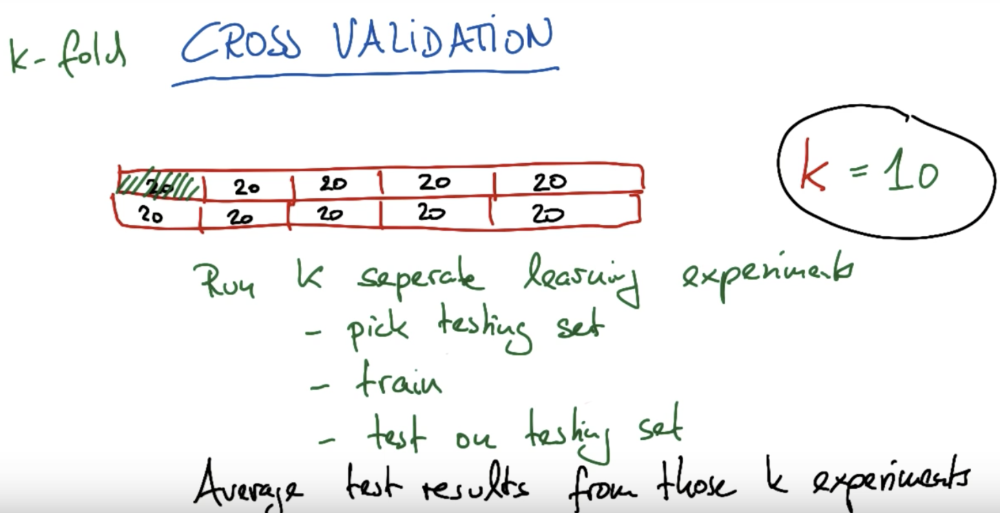

Note that there is another tradeoff here. Sometimes we just want to minimize training or running time, so using cross validation will be very time consuming.

__Next, lets take a look of coding of cross validation methodology__

The following example is to used ML to identify the author of a text message
***
```python
from sklearn.cross_validation import KFold

t0 = time()

kf = __KFold(len(authors),2, shuffle = True)__

for __train_indices__, __test_indices__ in kf:

    #Making training and testing dataset
    
    features_train = [word_data[ii] for ii in train_indices]
    
    features_test = [word_data[ii] for ii in test_indices]
    
    authors_train = [author[ii] for ii in train_indices]
    
    authors_test = [author[ii] for ii in test_indices]
```

Explanation of above code:

for line 7, KFold is a function that will consume the dataset size, k-fold number and another shuffle parameter. This will return a indices of training and testing data. We use those indices to assign featues_train, test ... Do not forget to put it in a loop.  

Make sure that you select shuffle = true otherwise we might put all data with the same feature into training set while putting all data with another feature into testing set. The result is that the accuracy score will be extremely low. Shuffle can make Kfold randomly select a value rather than following order in one direction

Run the following code example for more details

In [9]:
from sklearn.cross_validation import KFold
kf = KFold(20,4)
for train,test in kf:
    print train, test

[ 5  6  7  8  9 10 11 12 13 14 15 16 17 18 19] [0 1 2 3 4]
[ 0  1  2  3  4 10 11 12 13 14 15 16 17 18 19] [5 6 7 8 9]
[ 0  1  2  3  4  5  6  7  8  9 15 16 17 18 19] [10 11 12 13 14]
[ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14] [15 16 17 18 19]


#### Another significant benefit for using cross validation is that it can help you pick the best parameter for machine learning modelling. (Remeber that we have to adjust multiple times when using SVM to get those optimal paramter numbers like c value. kernel...)

Here is coding example:

```parameter = {'kernel':('linear', 'rbf'), 'C':[1,10]}
svr = svm.SVC()
clf = grid_search.GridSearchCV(svr, para,eters)
clf.fit(iris.data, iris.target)```

Explanation:

```parameter = {'kernel':('linear', 'rbf'), 'C':[1,10]}```

We give algorithm options of potential kernel: linear or rbf and C might be either 1 or 10. We ask it to help us find the best combination of kernel and C for this fitting and training

Then computer will generate a net table:



|(rbf, 1)  |(rbf, 10) |
|:------|----------|
|__(linear,1)__|__(linear,1)__|

Each group of those 4 will be used to train SVM and then cross validation will be used to examine the result

```svr = svm.SVC()``` Here we create a algorithm (not classifier, because clf classifier will be created on the next line) for next usage

```clf = grid_search.GridSearchCV(svr, parameters)```

The above line is to try different possibilities using information on the above table. we pass classifier svr and parameters to try.

```clf.fit(iris.data, iris.target)``` After ```gridsearch``` function finds the optimal combination and returns a optimal classifier, clf. And now we can train our data using this classifier.

__You may use ```clf.best_params``` to get the optimal parameter's values__


-------------------------------------------------

### Lecture 25 Evaluation Metrics

How you can tell if your machine learning algorithm is getting better and how you are doing overall

|Classification                    |Regression         |
|-----|:----|
|categorize y into different groups| Use x to predict y|
|We care if we categorize y into right group.| We care the diff between precition and actual value.|


A simple metrics we have used : __accuracy__
= # of corrected labeled / # of total data

Shortcomings of accuracy:

+ __not ideal for skewed classes__ (i.e denomintor may be small of accracy is large but not trustworthy)

+ __may want to error on side of guressing innocent__(would rather make more guilty people as innocent than making one innocent people guilty)

+ __may want to error on side of guessing guilty__

___ There are cases that you care about one situation than the other, that is why we need to introduce more metrics for difference cases now___

***

## Classification Metrics:

### 1. Confusion Matrix

A 2 by 2 matrix that compares the actual class with predicted class


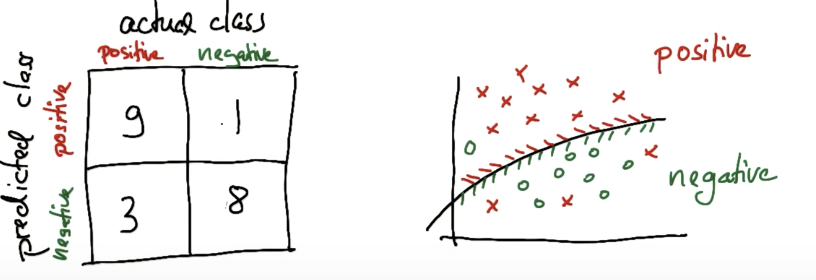

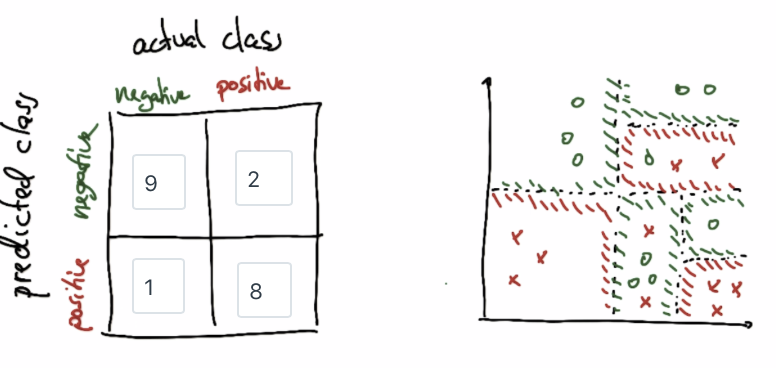

##### RECALL & PRECISION

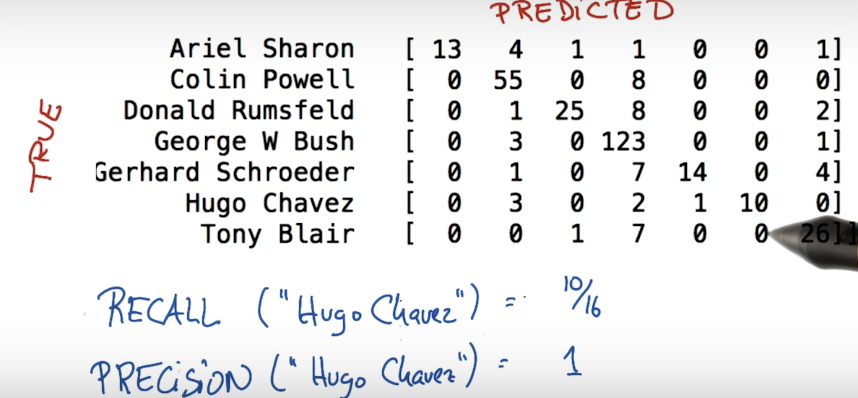

Check the Confusion Matrix in the picture above.

__recall("Huge Chavex") :__ Assume we know this person is "Huge Chavex", what is the accuracy that machine classifies him correctly?

__precision("Huge Chavex") :__ Assume that machine precits that this person is "Huge Chavex", what is the percentage that he actually is "huge"?

__Practice__

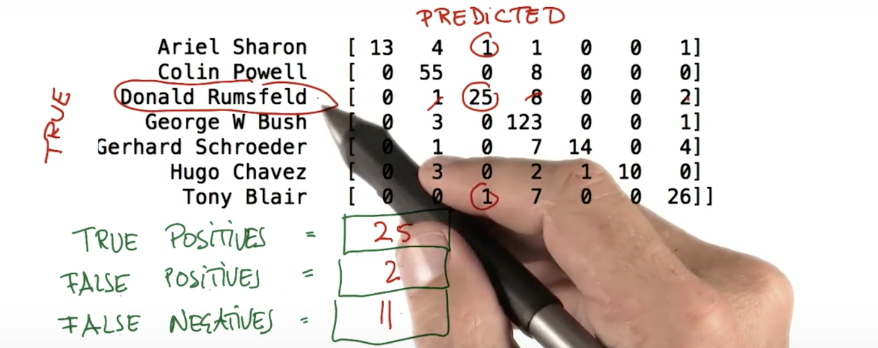


```Precision = true positive / (true positive + false positive)```

```Recall = true positive / (true positive + false negative)```

#### [F1 Score (Balanced F-Score)](http://scikit-learn.org/stable/modules/generated/sklearn.metrics.f1_score.html#sklearn.metrics.f1_score)

F1 score can be understanded as the weighted average of precision and recall. The best f1 score is 1 while the worst is 0

```F1 = 2 * (precision * recall) / (precision + recall)```

### Regression Metrics: 

#### (Note that for all regression metrics, the higher the score, the better the performance)

#### 1. [Mean Absolute Error](http://scikit-learn.org/stable/modules/generated/sklearn.metrics.mean_absolute_error.html#sklearn.metrics.mean_absolute_error)

Calculate the absolute difference betweek actual and prediction and then sum them together and divide by total number to achive average absolute error/difference

#### 2. [Mean Squared Error](http://scikit-learn.org/stable/modules/generated/sklearn.metrics.mean_squared_error.html#sklearn.metrics.mean_squared_error)
Compared to Mean Abosulte Error, this method will calculate the square value of difference. So the benefit of doing so is that we will turn all the difference into positive values and enlarge the difference. This difference can be differentiable in calculus.

#### 3. [R2 Score](http://scikit-learn.org/stable/modules/generated/sklearn.metrics.r2_score.html#sklearn.metrics.r2_score) (Coefficient of Determination)

This is the default method of checking performence for regression method in sklearn.

Best possible score is 1.0 and it can be negative (because the model can be arbitrarily worse). A constant model that always predicts the expected value of y, disregarding the input features, would get a R^2 score of 0.0.


If $\hat{y}_i$  is the predicted value of the i-th sample and $y_i$ is the corresponding true value, then the score R² estimated over $n_{\text{samples}}$ is defined as

$
R^2(y, \hat{y}) = 1 - \frac{\sum_{i=0}^{n_{\text{samples}} - 1} (y_i - \hat{y}_i)^2}{\sum_{i=0}^{n_\text{samples} - 1} (y_i - \bar{y})^2}
$

where $ \bar{y} =  \frac{1}{n_{\text{samples}}} \sum_{i=0}^{n_{\text{samples}} - 1} y_i.
$

#### 4. [Explained Variance Score](http://scikit-learn.org/stable/modules/generated/sklearn.metrics.explained_variance_score.html#sklearn.metrics.explained_variance_score)

If $\hat{y}$ is the estimated target output, y the corresponding (correct) target output, and $Var$ is Variance, the square of the standard deviation, then the explained variance is estimated as follow:

$
\texttt{explained_variance }(y, \hat{y}) = 1 - \frac{Var\{ y - \hat{y}\}}{Var\{y\}}
$

 -------------------------------------------------

### Lecture 27 Reason For Causing The Test Difference

Here we will talk about what reasons may result in the wrong prediction of our models. There are mainly two things causing this difference: __Bias and Variance__

There could be two posssible reasons:

+ __Our model has enough training data but model itself is too naive and  cannot represent the complicity/relationship of data/feature and this result in bias__

    + For example, data is categorized based on size and color but our model can only check feature color; Or our model can only represent linear relationship of dataset...
    

+ __Model is too much sensitive to our limited sized training dataset and this result in variance__

__Let me well explain the variance concept in details below:__

During training, we use some subsets of a large data pool to train our model. Each time we randomly pick a subset and train our model based on it. Obviously, there will be predictable difference when we use different subsets to train model. Here, variance is a word to measure the predictable difference when using different data subsets.

It is common and okay to have variance but if the variance is way too large and this shows that our model cannot generalize the predicted result to more datasets. In another word, our model is too sensitive to different subsets of training data (__overfitting__). Often at this condition, our model will become overwhemingly complicated and we do not have enough training dataset to deal with it.

At the above overfitting situation, we usually use two ways to resolve the overfitting:

1. __Use more data to train models__
2. __Reduce/limit complicity__ (maybe by reducing/combining features or changing parameters and etc)

__high bias__: pays little attention to data (oversimplified) -> high error on training set -> low r squared, high SSE value

__high variance__: pays too much attention to data (overfits) -> __much higher error on test set than on training set(A good fit for training set actually)__ 

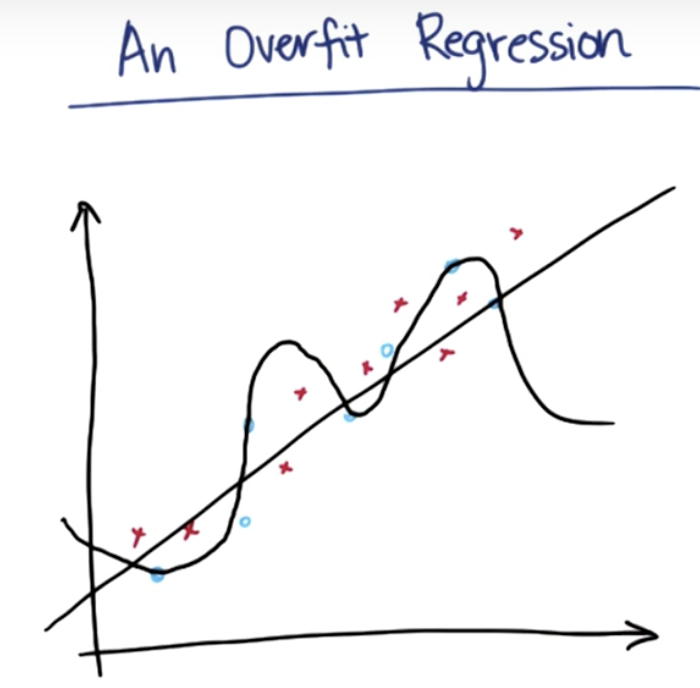

### Learning Curve

Learning curve is used to identify wiether the model is good or not by using data points.
```python
from sklearn.learning_curve import learning_curve # sklearn 0.17
from sklearn.model_selection import learning_curve # sklearn 0.18

learning_curve(
        estimator, X, y, cv=cv, n_jobs=n_jobs, train_sizes=train_sizes)
```
+ ```estimator``` is the current model we are using for prediction, it could be ```GaussianNB()``` for example.
+ ```x``` and ```y``` are __features and targets__
+ ```cv``` is the cross validation generator (```KFold()``` for example)
+ ```n_jobs``` is the parameter for parallel calculation
+ ```train_sizes``` is the number of data points used to generate the curve


Regressor score: 1.0000


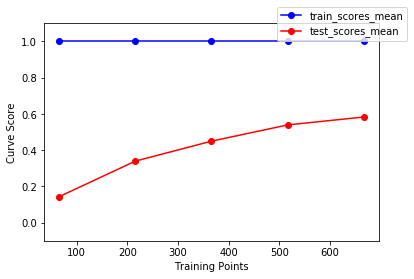

In [17]:
# we'll examine a learner which has high variance, and tries to learn
# nonexistant patterns in the data.
# Use the learning curve function from sklearn.learning_curve to plot learning curves
# of both training and testing error.
%matplotlib inline
from sklearn.tree import DecisionTreeRegressor
import matplotlib.pyplot as plt
# PLEASE NOTE:
# In sklearn 0.18, the import would be from sklearn.model_selection import learning_curve
from sklearn.learning_curve import learning_curve # sklearn version 0.17
from sklearn.cross_validation import KFold
from sklearn.metrics import explained_variance_score, make_scorer
import numpy as npd

# Set the learning curve parameters; you'll need this for learning_curves
size = 1000
cv = KFold(size,shuffle=True)
score = make_scorer(explained_variance_score)

# Create a series of data that forces a learner to have high variance
X = np.round(np.reshape(np.random.normal(scale=5,size=2*size),(-1,2)),2)
y = np.array([[np.sin(x[0]+np.sin(x[1]))] for x in X])

def plot_curve():
    # Defining our regression algorithm
    reg = DecisionTreeRegressor()
    # Fit our model using X and y
    reg.fit(X,y)
    print "Regressor score: {:.4f}".format(reg.score(X,y))
    
    #  Use learning_curve imported above to create learning curves for both the
    #       training data and testing data. You'll need reg, X, y, cv and score from above.
    
    train_sizes, train_scores, test_scores = learning_curve(reg, X, y,scoring=score,cv=cv, n_jobs=1)    
    # Taking the mean of the test and training scores
    train_scores_mean = np.mean(train_scores,axis=1)
    test_scores_mean = np.mean(test_scores,axis=1)
    
    # Plotting the training curves and the testing curves using train_scores_mean and test_scores_mean 
    plt.plot(train_sizes ,train_scores_mean,'-o',color='b',label="train_scores_mean")
    plt.plot(train_sizes,test_scores_mean ,'-o',color='r',label="test_scores_mean")
    
    # Plot aesthetics
    plt.ylim(-0.1, 1.1)
    plt.ylabel("Curve Score")
    plt.xlabel("Training Points")
    plt.legend(bbox_to_anchor=(1.1, 1.1))
    plt.show()
    
    
plot_curve()

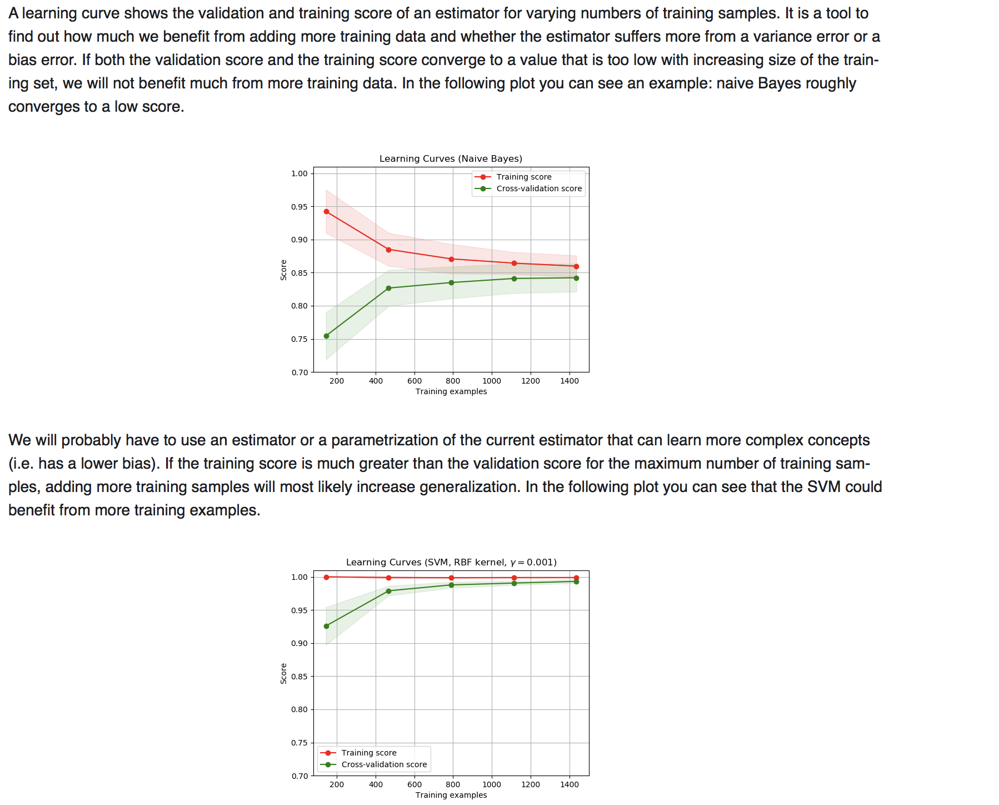


__More about learning curve :__

We separate the training and testing datasets in order to better see if our model can react good to some new data rather than checking it with the already seen data

For learning curve, when the training and testing curves are stable and the distance between them are stable, we believe that our model has tried the best to know the data

+ __when the training and testing curves convenges together and quite high, this means our model has bias. No matter how much data we provide, the model cannot show the basic relationship. Like the above first graph__


+ __when the training and testing have a huge difference, this shows our model has big variance. Different from high bias, if we provide with more data for training or we can simplify the features, we can usually improve our model__

___________
_____________
_______________
_________
________

# Chapter Two

## Supervised Learning

+ __Supervised Learning: Function Approximation (Induction)__
    + we have labed data and use it to predict something
   
   
+ __Unsupervised Learning: Concise Description (no feedbacks)__
    + we have some inputs but not labeled data, but we can analyze those input and derive some features ( there are assumed labels ...)
       
       For example, we find some animals and we find they are similar to dogs so we think they are in the same group as dog, but we do not have label called dog. We tell by describing them based on their features to group them. No one tells you the feature you choose to group them is right or wrong

For unsupervised learning, sometimes we can try a different approach and label it (use some tricks from supervised learning)

+ __Reinforced Learning: learning from delayed rewards__

    Unlike supervised learning in which for each step you make, you know whether it is right or wrong by labels. Unlike unsupervised learning that you will never get feebacks, reinforced learning is that you make certain amount of steps without knowing if they are correct, But eventually you will know if you succeed or fail. This is like playing a game, until you know whether you win or lose, you do not know if your steps are all right or not. If you lose, maybe one of your step you made before is wrong, but you do not know that at the time you place that chess. And now you need to trace back to know which step is wrong. Or if you win, you wish to know which step is crucial for your win. Again unlike supervised learning, each step you make, you know the label/feedback that if it is right or wrong


+ Induction: getting from individual examples to a generalized rule

+ Deduction: getting a specific result by using the general rule

__Comparision of Three Machine Learning Methods__

__About Optimization Result:__

1. Supervised: labels data well
2. Reinforcement: behavior scores well
3. Unsupervised: cluster scores well

### Order of The Following Sections:


 1.0 Classification (Decision Tree)
    
    
 2.0 Regression (cts input to cts output)

 3.0 Neural Network

---
### Supervised Learning

#### Decision Tree

Expression:
1. ```A AND B```
2. ```A OR B```
3. ```A XOR B```: If A or B is true individually, its true. When A and B are both true, A XOR B is __false__

    For the case that there are n arrtibutes with relationship ```XOR```, we need to consider parity. If total number of Ture is even for one branch, the result for that branch is false. It is true otherwise. For example, A, B, C are all true, then the result is true. If A, B, C are all false, thats even number of true, so the result is false
    
__Running time of OR and XOR__:

For OR, it is O(n) -> linear

For XOR, it is O(2^n) -> Exponential

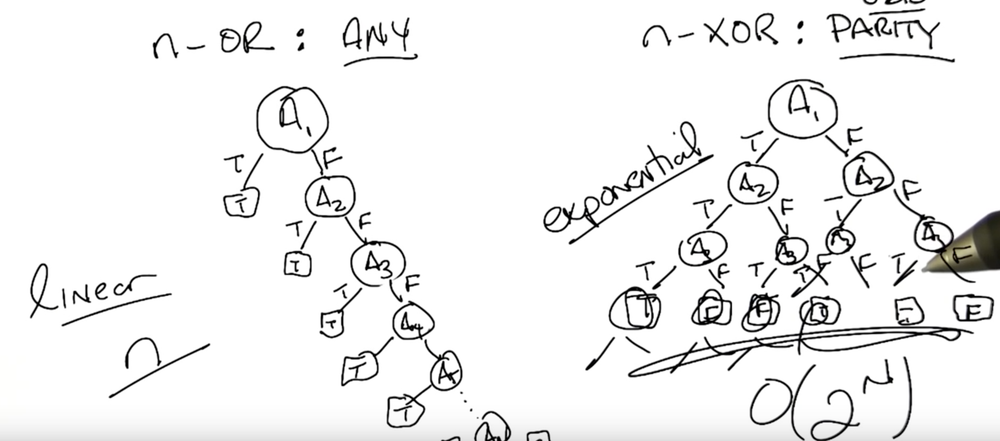

__Let's imvestigate on the complexity of decision tree:__

Imagine there are n attributes that are boolean and our final outputs are all boolean as well. To find out how many outputs, we will draw a truth table. Since each variable can be true or false and there are n attributes, we will eventually have 2^n rows turth table. But this still does not tell us the complexity. We need to think how many possible ways to fill in the outputs. Remember each row can either by a result of true or false and there are 2^(2^n)) combinations of final results for that truth table

Remark that this double exponential functions goes rapidly and is evil. In reality, we need some techniques to smartly search and build the decision tree.

Here is a methodology: ```ID3```
```
Loop:

+ A <- best attribute based on information gain
+ Assign A as decision aattribute for node
+ For each value of A, create a descendent of node
+ Sort trainings examples to leaves
+ If examples perfectly classified, then stop
+ else iterate over leaves
```

Information Gain: Reduction of randomness
Entropy: A measure of randomness
+ S: collection of training examples
+ A: A Particular Attribute

__Bias of ID3__

+ __Restriction bias__ : Restricted by hypothesis/rules
+ __preference bias__ : bias caused by our difference preference. For example, when different people conduct decision tree, they construct it differently. A good decision tree has some attributes like "a good split at the top", "produce more right answers than wrong ones", "shorter tree than longer tree"... So the way you design the DT will cause preference bias.

__Other Consideration__

1. Continuous Attributes? -> we range it (like age < 5 ...)

2. When do we stop?

  -> when everything classified correctly (but what if we have noise)
  
  -> No more attributes
      + build all tress and check for cross validation score, so we do not need to worry about when to stop
      + everytime you try to build a branch, check for cross validation score and if the score is low enough, you stop growing the tree
      + After building the tree, we can reexamine the branches. We can cut some branches and collapse it back to see if it's better
      
3. Does it make sense to repeat an attribute along a path in the tree?

along the path means : A -> B -> A not B ->-> A A 

if along the path, then answer is Yes for continuous and No for discrete. For example, if A attribute is age, then first A is if you are below 40, if yes, then you pick something for B and then back to A (age) again and this time A can be "if you are below 30"

__Regression Outputs__

What if our outputs are continuous? Then we cannot use infomration gain since it does not split/measure perfectly. Now we can think about measure by variance. For leaves, we might need to do a average or a vote (true of false)

---
### Supervised Learning

#### Neaural Network

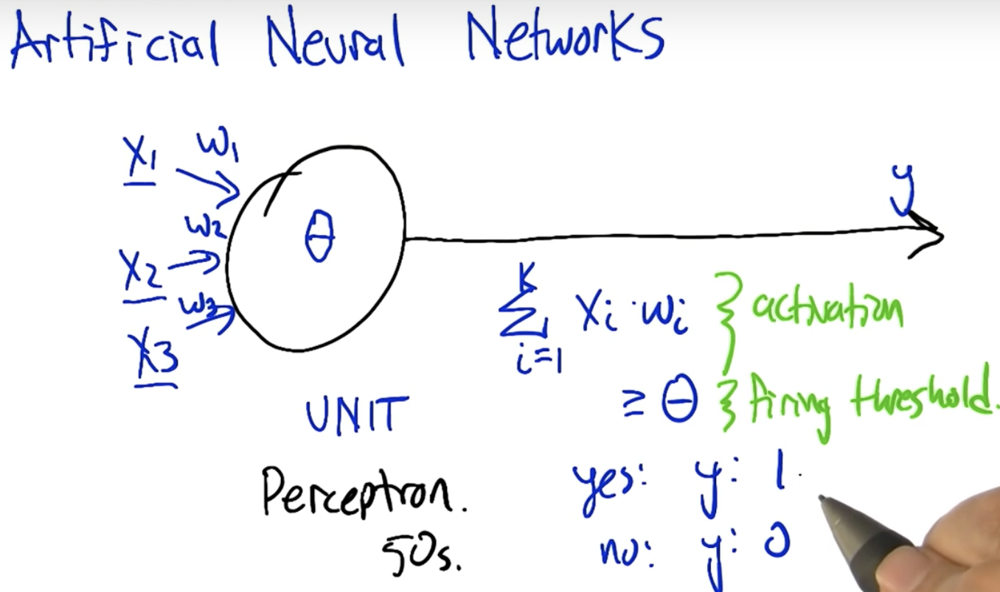

_note x is the input and w is the weight. We are trying to see if all input with their weights together can reach the firing threshold_

__Perceptron is a linear functions and it will always generate a linear seperation line to seperate areas. It computes hyperplane__

### Power of Neaural Network - AND, OR, XOR

### AND: (treat 0 as false and 1 as true)
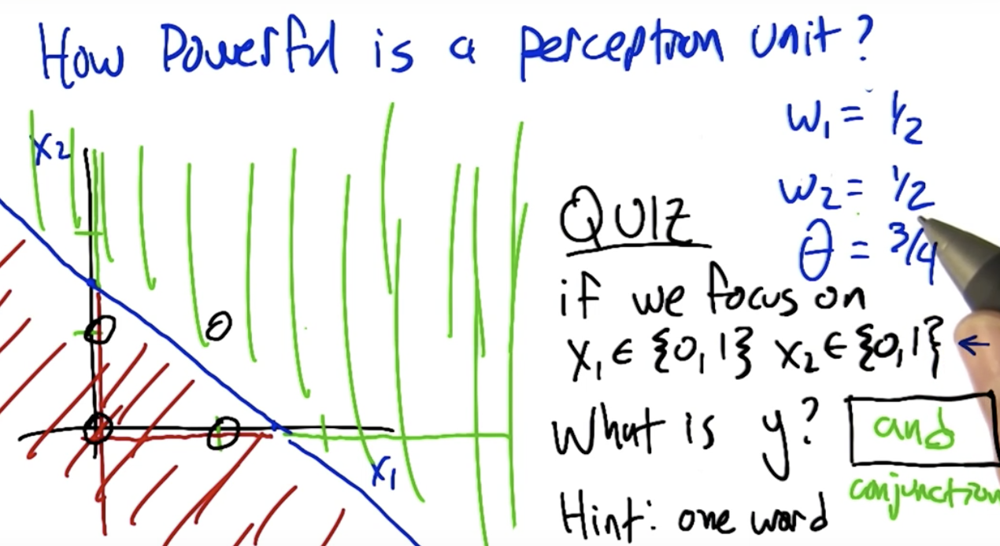

### OR - How will you define w1, w2 and theta? Answer's not unique

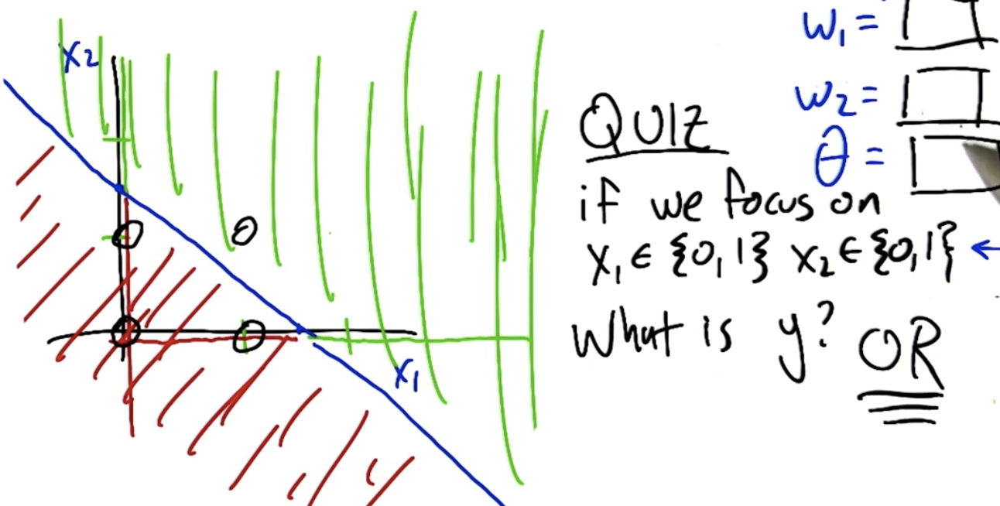

_(I put w1 = w2 = theta = 1)_

### Not - One Variable Case

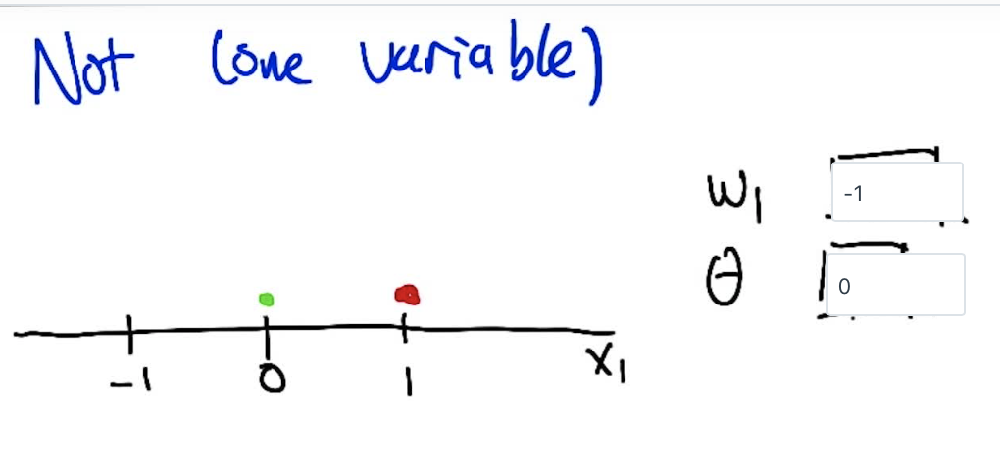

### XOR - Tricky One




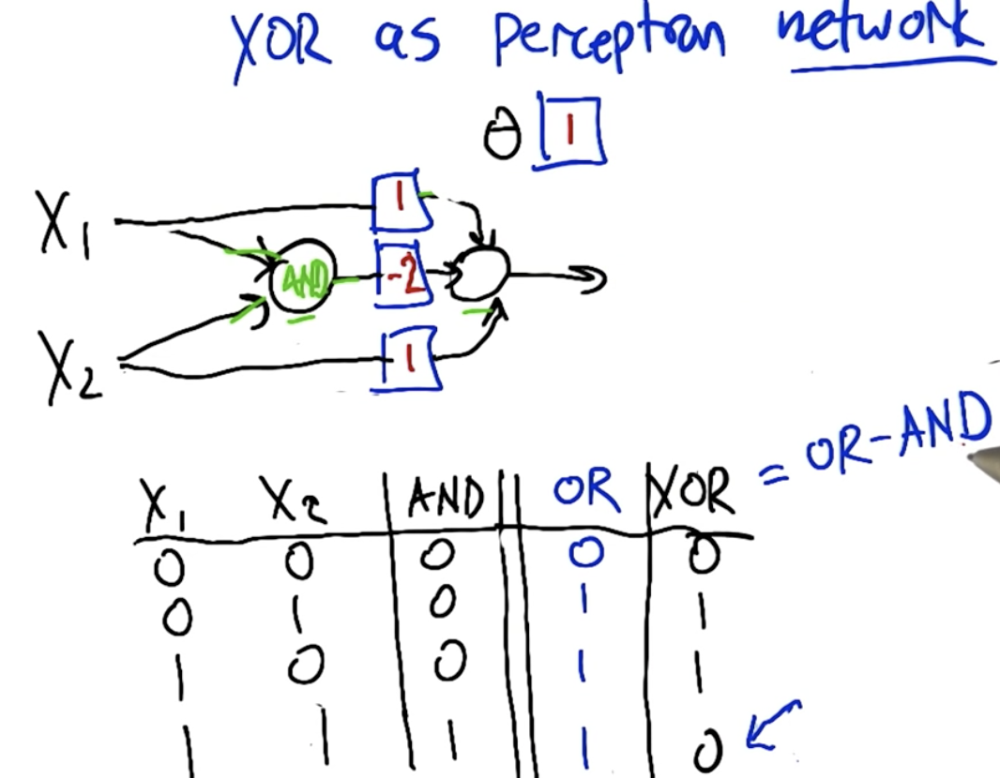

Note that the tricky part is to decide the value for the middle square. If we set it as -1, then when x and y are both true, the total value summed is 1*1 + 1*1 + -1 * 1(this 1 is from AND). so it still reaches the firing threshold. thats why we need it to be more smaller as -2

### Perceptron Training

Given examples, find weights that map inputs to outputs

- perceptron rule (use threshold)
- gradient descent/ delta rule (no threshold)

__Perception Rule:__

__Linear Seperation__

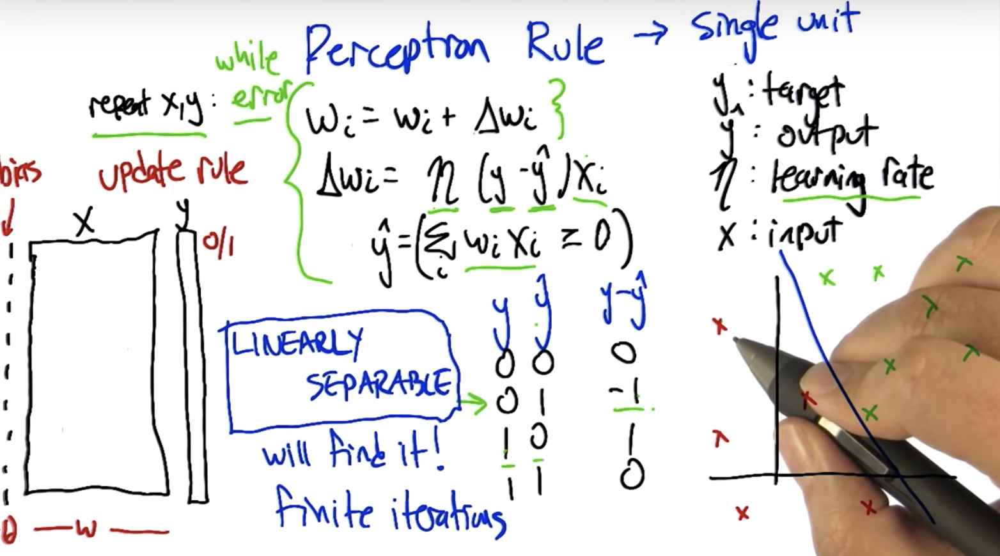

- As long as the dataset is linearly seperable, we can use perception rule to find it within finite iterations __for sure (guarantee)__!
- In this case, we only consider to find one line with y=ax and try to find a proper weight to x (which is a) to separate the data.
- Except x and y, we have bias. bias is because we would like to compare with 0 not threshold. so we minus theta. When we take x value, we directly minus scaled theta, which is considered as bias here
- y is the output we want taking this x value with bais. y-bar is the output of the whole network, which will be unchanged during iteration
- The idea of ```y - y_bar``` is that if current network output is 1 but the goal of output is 1, it means our current weight is too large. we do y - y_bar and get -1. Now, by multiplying with learning rate, we shift w to make it smaller. The same logic if we get 0 while the goal is 1. we do the subtraction and get 1. And then we modify weight to make it larger. 
- Learning rate is here becasue we do not want to adjust our weight too much each time
- if we find the correct weight, then our w will not be changed during iteration. So we will put a while loop condition here to examine when we need to stop the loop (when we get the corret w already)

__Gradient Descend__

   __Designed for non-linear seperation__
   
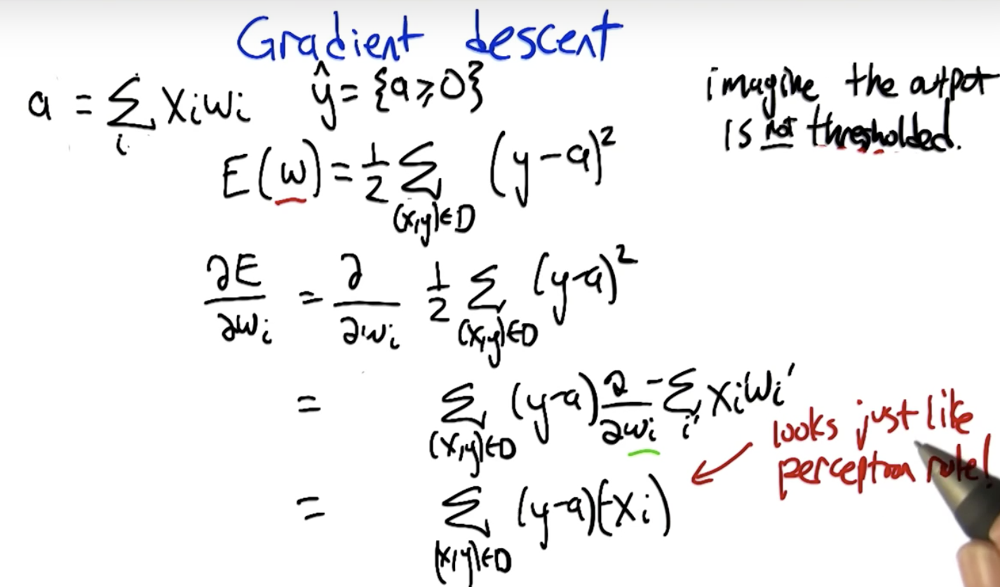

- For gradient descend, we would like to figure out the direction of descending and then take a little step for the negative direction of that.
- For this, we do not have the threshold to compare (subtract) with like preceptron rule. We are not subtracting y_bar but rather this is like how to examine the difference in regression. y is the ideal output we want and a is the activation function. we subtract them to see the difference. And then we will examine the "direction of that difference" by taking direvative. After getting direction, we ```times learning rate and "direction"``` and add this to weight to adjust its value.

__Compare GD and PR__

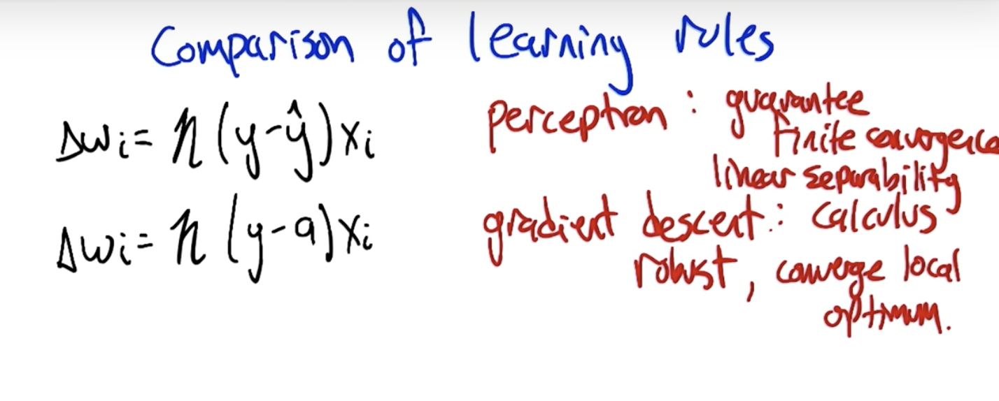
 
__Note for PR, we threshold it and determine whether its fired or not (1 or 0). For GD there is no thresholding__ 

__Question: Why do not we use gradient descend on y_bar but a?__

Because y_bar is not differentiable. it is more like a function with shape:  
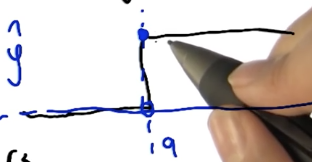

But it is possible that we can make that jump a little softer (softer threshold) so that the jump will be differentiable as well

__Sigmoid Function (S curved, differentiable jump)__

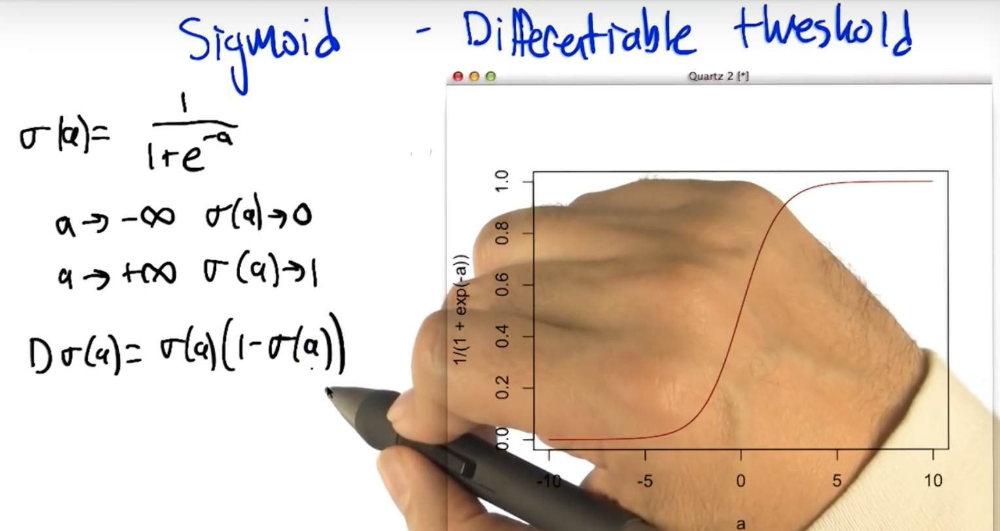

This function is differentiable everywhere. So we can apply gradient descend here. And also the derivative has a good form to compute.

[To see derivative of sigmoid or more info, click here](http://mathworld.wolfram.com/SigmoidFunction.html)

##  Network of Neaural Network:

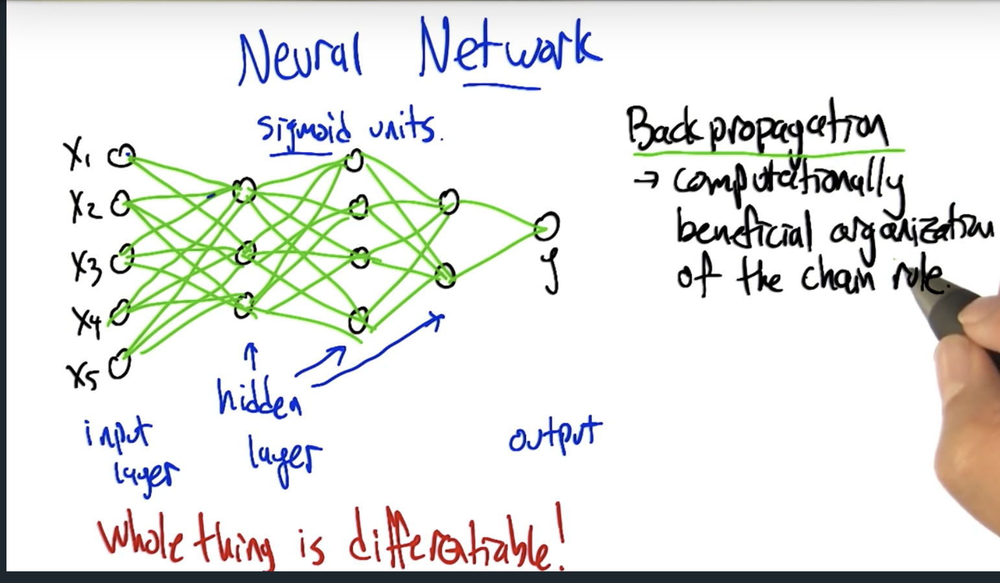

- Except the middle sigmoid units, the input and output are called input/output layers. Those middle dots are hidden layers. to jump from input to each next layer, we compute the input * weight on each green line
- Since all nodes are sigmoid unit, the mapping from input to output is differentiable -> we can fugure out for any given weight in the network, by moving it up or down by a little bit, its going to change the mapping to provide us more more ideal result even though there are those non-linearity in between
- __The meaning of this network is that the whole mapping from input through hidden layers to outputs is differentiable. We can also compute the derivative of any single green line.  This means we can move any single weight (green line) up or down to see the changes on output. We can adjust the mapping by doing so, even though the mapping is not linear at all__

__Shortingcomings of using gradient descend:__

One of the problem when you run gradient descend in large and complex dataset is you might get stuck in a local minimum and think that is the best mapping(becasue by moving some weight, you cannot get a smaller error). But actually it is just because you are getting a local minimum but not globally. Maybe if you try to move more weights around and you could get a better result.

__So is there another way for us to find the weight in the neaural network?__

- Using higher derivatives, randomized optimization or adding penalty when using structure that are too complex (like regression or decision tree) are some methods
- more nodes and layers may bring overfitting
- if just the weight is too large, it may also causes overfitting so we sometimes would like to keep the weight in a range

__To initialize gradient descend or GR method, we start with a small values and gives it some variability (start with low complexity) Do not do any thing unnecessary unless you are getter fitting__

# Must Read: 
<span style="color:red">https://discussions.youdaxue.com/t/topic/6357</span> 

## Some Exercises:


In [2]:
# In this exercise, you will add in code that decides whether a perceptron will fire based
# on the threshold. Your code will go in lines 32 and 34. 
import numpy as np

class Perceptron:
    """
    This class models an artificial neuron with step activation function.
    """
    def __init__(self, weights = np.array([1]), threshold = 0):
        """
        Initialize weights and threshold based on input arguments. Note that no
        type-checking is being performed here for simplicity.
        """
        self.weights = weights
        self.threshold = threshold
    
    def activate(self,inputs):
        """
        Takes in @param inputs, a list of numbers equal to length of weights.
        @return the output of a threshold perceptron with given inputs based on
        perceptron weights and threshold.
        """ 

        # The strength with which the perceptron fires.
        strength = np.dot(self.weights, inputs)
        # TODO: return 0 or 1 based on the threshold
        if strength <= self.threshold :
            self.result = 0
        else:
            self.result = 1    
        return self.result
    
# note what is numpy.dot(a,b,out=None)
# if both a and b are one dimension arrays, its inner product
# if both a and b are two dimension arrays, its matrix multiplication
# if either a or b is 0-D(scalar), it is a * b
# if a is N-D and b is 1-D arrays, its a sum product over the last axis of a and b
# is b is N-D and a is M-D(M>=2)arrays, its a sum product over the last axis of a and the second-to-last axis of b

def test():
    """
    A few tests to make sure that the perceptron class performs as expected.
    Nothing should show up in the output if all the assertions pass.
    """
    p1 = Perceptron(np.array([1, 2]), 0.)
    assert p1.activate(np.array([ 1,-1])) == 0 # < threshold --> 0
    assert p1.activate(np.array([-1, 1])) == 1 # > threshold --> 1
    assert p1.activate(np.array([ 2,-1])) == 0 # on threshold --> 0

if __name__ == "__main__":
    test()

In [10]:
# In this exercise, you will update the perceptron class so that it can update
# its weights.
#
# Finish writing the update() method so that it updates the weights according
# to the perceptron update rule. Updates should be performed online, revising
# the weights after each data point.

import numpy as np

class Perceptron:
    """
    This class models an artificial neuron with step activation function.
    """
    def __init__(self, weights = np.array([1]), threshold = 0):
        """
        Initialize weights and threshold based on input arguments. Note that no
        type-checking is being performed here for simplicity.
        """
        self.weights = weights.astype(float) 
        self.threshold = threshold


    def activate(self, values):
        """
        Takes in @param values, a list of numbers equal to length of weights.
        @return the output of a threshold perceptron with given inputs based on
        perceptron weights and threshold.
        """
        # First calculate the strength with which the perceptron fires
        strength = np.dot(values,self.weights)
        # Then return 0 or 1 depending on strength compared to threshold  
        return int(strength > self.threshold)


    def update(self, values, train, eta=.1):
        """
        Takes in a 2D array @param values consisting of a LIST of inputs and a
        1D array @param train, consisting of a corresponding list of expected
        outputs. Updates internal weights according to the perceptron training
        rule using these values and an optional learning rate, @param eta.
        """

        # For each data point:
        for data_point in xrange(len(values)):
            # TODO: Obtain the neuron's prediction for the data_point --> values[data_point]
            prediction = self.activate(values[data_point])
            # Get the prediction accuracy calculated as (expected value - predicted value)
            # expected value = train[data_point], predicted value = prediction
            error = train[data_point] - prediction
            # TODO: update self.weights based on the multiplication of:
            # - prediction accuracy(error)
            # - learning rate(eta)
            # - input value(values[data_point])
            weight_update = 0.1 * error * values[data_point]
            self.weights += weight_update
            print self.weights

def test():
    """
    A few tests to make sure that the perceptron class performs as expected.
    Nothing should show up in the output if all the assertions pass.
    """
    def sum_almost_equal(array1, array2, tol = 1e-6):
        return sum(abs(array1 - array2)) < tol

    p1 = Perceptron(np.array([1,1,1]),0)
    p1.update(np.array([[2,0,-3]]), np.array([1]))
    assert sum_almost_equal(p1.weights, np.array([1.2, 1, 0.7]))

    p2 = Perceptron(np.array([1,2,3]),0)
    p2.update(np.array([[3,2,1],[4,0,-1]]),np.array([0,0]))
    assert sum_almost_equal(p2.weights, np.array([0.7, 1.8, 2.9]))

    p3 = Perceptron(np.array([3,0,2]),0)
    p3.update(np.array([[2,-2,4],[-1,-3,2],[0,2,1]]),np.array([0,1,0]))
    assert sum_almost_equal(p3.weights, np.array([2.7, -0.3, 1.7]))

if __name__ == "__main__":
    test()

[1.2 1.  0.7]
[0.7 1.8 2.9]
[0.7 1.8 2.9]
[2.8 0.2 1.6]
[ 2.7 -0.1  1.8]
[ 2.7 -0.3  1.7]


__Some good questions about nearural network:__

<span style="color:red">1. Neaural Networks are built out of components like perceptron units. What do inputs to networks of perceptrons look like?</span>
    
    A Matrix of numerical values with classifications for each row.

<span style="color:green">Remark: input is numerical number and outputs are classifications</span>
    
<span style="color:red">2. What information can we get as the output of a neural network?</span>
    
    - A directed graph, the neural network itself
    - A single scalar-valued number
    - The classification of a vector
    - A vector valued output for any vector input

<span style="color:green">remark: neural network is very flexible</span>

<span style="color:red">3. Given the weights for the hidden layers of ```[1,1,-5]``` and ```[3,-4,2]```, and weights for output layer of ```[2,-1]```, what will this network output for input ```[1,2,3]```?
Assume we know the structure of layers as:</span>

<span style="color:red">[[node, node,node],  #input layer</span><br>
<span style="color:red">[node, node],        #hidden layer</span><br>
<span style="color:red">[node]]              #output </span>

    - answer is (-25)
    
<span style="color:red">4. Given a network with structure [2,2,1], that is two input nodes, two hidden nodes and one output node, how many possible prices could the network assi gn to a house?</span>

    - answer is 4

In [3]:
# In this exercise, you will create a network of perceptrons that can represent
# the XOR function, using a network structure like those shown in the previous
# quizzes.
#
# You will need to do two things:
# First, create a network of perceptrons with the correct weights
# Second, define a procedure EvalNetwork() which takes in a list of inputs and
# outputs the value of this network.
#
# ----------

import numpy as np

class Perceptron:
    """
    This class models an artificial neuron with step activation function.
    """

    def __init__(self, weights = np.array([1]), threshold = 0):
        """
        Initialize weights and threshold based on input arguments. Note that no
        type-checking is being performed here for simplicity.
        """
        self.weights = weights
        self.threshold = threshold


    def activate(self, values):
        """
        Takes in @param values, a list of numbers equal to length of weights.
        @return the output of a threshold perceptron with given inputs based on
        perceptron weights and threshold.
        """
               
        # First calculate the strength with which the perceptron fires
        strength = np.dot(values,self.weights)
        
        # Then return 0 or 1 depending on strength compared to threshold  
        return int(strength > self.threshold)

            
# Part 1: Set up the perceptron network
Network = [
    # input layer, declare input layer perceptrons here
    [ Perceptron(np.array([1,1]), 0.5), Perceptron(np.array([-1.5,-1]),-1.6) ], \
    # output node, declare output layer perceptron here
    [ Perceptron(np.array([1,1]), 1.5) ]
]

# Part 2: Define a procedure to compute the output of the network, given inputs
def EvalNetwork(inputValues, Network):
    """
    Takes in @param inputValues, a list of input values, and @param Network
    that specifies a perceptron network. @return the output of the Network for
    the given set of inputs.
    """
    results = [node.activate(inputValues) for node in Network[0]]
    outputValue = Network[1][0].activate(np.array(results))
    return outputValue



def test():
    """
    A few tests to make sure that the perceptron class performs as expected.
    """
    print "0 XOR 0 = 0?:", EvalNetwork(np.array([0,0]), Network)
    print "0 XOR 1 = 1?:", EvalNetwork(np.array([0,1]), Network)
    print "1 XOR 0 = 1?:", EvalNetwork(np.array([1,0]), Network)
    print "1 XOR 1 = 0?:", EvalNetwork(np.array([1,1]), Network)

if __name__ == "__main__":
    test()

0 XOR 0 = 0?: 0
0 XOR 1 = 1?: 1
1 XOR 0 = 1?: 1
1 XOR 1 = 0?: 0


<span style="color:red"> One problem that perceptron units have is that their outputs are discrete. This makes it difficult to address regression problems with them, and requires them to have more complexity to capture some concepts.</span>

<span style="color:green"> To solve this problem, we will need to add another conversion function</span>

Let's examine the following functions to see which one is a better choice:

1. ```Sine``` - Nope! Because it is not monotonic(not continuously incr/decr) and will cause problems
2. ```Arctangent``` - Good choice, but not the best because it's expansive to calculate
3. ```Natural Logarithm``` - Nope! Doesn't make sense because the strength cannot be negative
4. ```Cube root``` - Nope! Infinity does not make sense!
5. ```Logistic function``` - Perfect choice!


<span style="color:red"> We need to train our network of sigmoid units like we trained networks of perceptrons. How could we determine the rule to train them?</span>
    - To deal with small, gradual changes of continuous functions. This is exactly where we should use calculus!
    
    
<span style="color:red">What are other problems using gradient descend?</span>

    - Local Extrema.
    - Lengthy run times.
    - Infinite loops.
    - Failure to completely converge.

In [ ]:
# ----------
# 
# As with the previous perceptron exercises, you will complete some of the core
# methods of a sigmoid unit class.
#
# There are two functions for you to finish:
# First, in activate(), write the sigmoid activation function.
# Second, in update(), write the gradient descent update rule. Updates should be
#   performed online, revising the weights after each data point.
# 
# ----------

import numpy as np


class Sigmoid:
    """
    This class models an artificial neuron with sigmoid activation function.
    """

    def __init__(self, weights = np.array([1])):
        """
        Initialize weights based on input arguments. Note that no type-checking
        is being performed here for simplicity of code.
        """
        self.weights = weights

        # NOTE: You do not need to worry about these two attribues for this
        # programming quiz, but these will be useful for if you want to create
        # a network out of these sigmoid units!
        self.last_input = 0 # strength of last input
        self.delta      = 0 # error signal

    def activate(self, values):
        """
        Takes in @param values, a list of numbers equal to length of weights.
        @return the output of a sigmoid unit with given inputs based on unit
        weights.
        """
        
        # YOUR CODE HERE
        
        # First calculate the strength of the input signal.
        strength = np.dot(values, self.weights)
        self.last_input = strength
        
        # TODO: Modify strength using the sigmoid activation function and
        # return as output signal.
        # HINT: You may want to create a helper function to compute the
        #   logistic function since you will need it for the update function.
        
        return result
    
    def update(self, values, train, eta=.1):
        """
        Takes in a 2D array @param values consisting of a LIST of inputs and a
        1D array @param train, consisting of a corresponding list of expected
        outputs. Updates internal weights according to gradient descent using
        these values and an optional learning rate, @param eta.
        """

        # TODO: for each data point...
        for X, y_true in zip(values, train):
            # obtain the output signal for that point
            y_pred = self.activate(X)

            # YOUR CODE HERE

            # TODO: compute derivative of logistic function at input strength
            # Recall: d/dx logistic(x) = logistic(x)*(1-logistic(x))

            # TODO: update self.weights based on learning rate, signal accuracy,
            # function slope (derivative) and input value
            

def test():
    """
    A few tests to make sure that the perceptron class performs as expected.
    Nothing should show up in the output if all the assertions pass.
    """
    def sum_almost_equal(array1, array2, tol = 1e-5):
        return sum(abs(array1 - array2)) < tol

    u1 = Sigmoid(weights=[3,-2,1])
    assert abs(u1.activate(np.array([1,2,3])) - 0.880797) < 1e-5
    
    u1.update(np.array([[1,2,3]]),np.array([0]))
    assert sum_almost_equal(u1.weights, np.array([2.990752, -2.018496, 0.972257]))

    u2 = Sigmoid(weights=[0,3,-1])
    u2.update(np.array([[-3,-1,2],[2,1,2]]),np.array([1,0]))
    assert sum_almost_equal(u2.weights, np.array([-0.030739, 2.984961, -1.027437]))

if __name__ == "__main__":
    test()